### Data Profiling ###
Some further data profiling action with the newly prepared `usage_stats` file from the hadoop cluster.

In [1]:
#import libraries
%matplotlib inline
import seaborn as sns
import pandas as pd
import pysal as ps
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import folium as fo
#import folium.plugins as plugins
import requests
import json
import os

#from geopy.geocoders import Nominatim
from geopy.distance import geodesic
from datetime import datetime, timedelta, timezone
from folium.plugins import HeatMap, MarkerCluster, TimestampedGeoJson

D:\Anaconda3\envs\prana\lib\site-packages\pysal\__init__.py:65: VisibleDeprecationWarning: PySAL's API will be changed on 2018-12-31. The last release made with this API is version 1.14.4. A preview of the next API version is provided in the `pysal` 2.0 prelease candidate. The API changes and a guide on how to change imports is provided at https://migrating.pysal.org
  ), VisibleDeprecationWarning)


In [2]:
df_stations = pd.read_csv("cycleusage_cleansed.csv")
df_stations.rename(columns = {'StartStation  latitude':'StartStation latitude', 'EndStation  latitude':'EndStation latitude'}, inplace = True)

In [64]:
df_stations.head(10)

,StartStation_Id,Start_Date,EndStation_Id,End_Date,Duration,StartStation_Id_Used,EndStation_Id_Used,Frequency,StartStation_Address,StartStation_latitude,StartStation_longitude,StartStation_capacity,EndStation_Address,EndStation_latitude,EndStation_longitude,EndStation_capacity,distance_(geodesic)
0,835,28/02/2019 19:30,597,28/02/2019 20:14,2640,2772,37356,1,"Farringdon Street, Holborn",51.516785,-0.104948,25,"Fulham Park Road, Fulham",51.473471,-0.207820,27,8.617622
1,839,20/12/2018 17:49,509,20/12/2018 17:58,540,2899,51254,16,"Sea Containers, South Bank",51.508033,-0.106824,30,"Fore Street, Guildhall",51.517842,-0.090075,19,1.594642
2,839,28/02/2019 17:56,509,28/02/2019 18:06,600,2899,51254,16,"Sea Containers, South Bank",51.508033,-0.106824,30,"Fore Street, Guildhall",51.517842,-0.090075,19,1.594642
3,839,26/02/2019 17:45,509,26/02/2019 17:56,660,2899,51254,16,"Sea Containers, South Bank",51.508033,-0.106824,30,"Fore Street, Guildhall",51.517842,-0.090075,19,1.594642
4,839,11/01/2019 16:55,509,11/01/2019 17:07,720,2899,51254,16,"Sea Containers, South Bank",51.508033,-0.106824,30,"Fore Street, Guildhall",51.517842,-0.090075,19,1.594642
5,839,18/03/2019 18:51,509,18/03/2019 19:06,900,2899,51254,16,"Sea Containers, South Bank",51.508033,-0.106824,30,"Fore Street, Guildhall",51.517842,-0.090075,19,1.594642
6,838,09/01/2019 12:39,562,09/01/2019 12:56,1020,3020,50217,6,"Fore Street Avenue, Guildhall",51.518093,-0.091402,25,"Bury Place, Holborn",51.517460,-0.123350,21,2.218761
7,838,16/11/2018 16:02,562,16/11/2018 16:28,1560,3020,50217,6,"Fore Street Avenue, Guildhall",51.518093,-0.091402,25,"Bury Place, Holborn",51.517460,-0.123350,21,2.218761
8,838,16/11/2018 16:01,562,16/11/2018 16:28,1620,3020,50217,6,"Fore Street Avenue, Guildhall",51.518093,-0.091402,25,"Bury Place, Holborn",51.517460,-0.123350,21,2.218761
9,838,07/11/2018 17:57,821,07/11/2018 18:28,1860,3020,24619,1,"Fore Street Avenue, Guildhall",51.518093,-0.091402,25,"Battersea Power Station, Battersea Park",51.483507,-0.147715,27,5.486078


In [4]:
print(df_stations.count())

def distance(row):
    """Get distance between pairs of lat-lon points"""
    return geodesic((row["StartStation latitude"], row["StartStation longitude"]), 
                    (row["EndStation latitude"], row["EndStation longitude"])).km

df_stations['distance (geodesic)'] = df_stations.apply(lambda row: distance(row),axis=1)
df_stations.head()


StartStation Id           6969624
Start Date                6969624
EndStation Id             6969624
End Date                  6969624
Duration                  6969624
StartStation Id Used      6969624
EndStation Id Used        6969624
Frequency                 6969624
StartStation Address      6969624
StartStation latitude     6969624
StartStation longitude    6969624
StartStation capacity     6969624
EndStation Address        6969624
EndStation latitude       6969624
EndStation longitude      6969624
EndStation capacity       6969624
dtype: int64


,StartStation Id,Start Date,EndStation Id,End Date,Duration,StartStation Id Used,EndStation Id Used,Frequency,StartStation Address,StartStation latitude,StartStation longitude,StartStation capacity,EndStation Address,EndStation latitude,EndStation longitude,EndStation capacity,distance (geodesic)
0,835,28/02/2019 19:30,597,28/02/2019 20:14,2640,2772,37356,1,"Farringdon Street, Holborn",51.516785,-0.104948,25,"Fulham Park Road, Fulham",51.473471,-0.207820,27,8.617622
1,839,20/12/2018 17:49,509,20/12/2018 17:58,540,2899,51254,16,"Sea Containers, South Bank",51.508033,-0.106824,30,"Fore Street, Guildhall",51.517842,-0.090075,19,1.594642
2,839,28/02/2019 17:56,509,28/02/2019 18:06,600,2899,51254,16,"Sea Containers, South Bank",51.508033,-0.106824,30,"Fore Street, Guildhall",51.517842,-0.090075,19,1.594642
3,839,26/02/2019 17:45,509,26/02/2019 17:56,660,2899,51254,16,"Sea Containers, South Bank",51.508033,-0.106824,30,"Fore Street, Guildhall",51.517842,-0.090075,19,1.594642
4,839,11/01/2019 16:55,509,11/01/2019 17:07,720,2899,51254,16,"Sea Containers, South Bank",51.508033,-0.106824,30,"Fore Street, Guildhall",51.517842,-0.090075,19,1.594642


In [5]:
#Max distance
print(df_stations.iloc[df_stations["distance (geodesic)"].idxmax()])
#Min distance
df_stations.iloc[df_stations["distance (geodesic)"].idxmin()]

StartStation Id                                    790
Start Date                            02/07/2018 17:18
EndStation Id                                      694
End Date                              02/07/2018 18:28
Duration                                          4200
StartStation Id Used                             28157
EndStation Id Used                               17393
Frequency                                            2
StartStation Address      Stratford Station, Stratford
StartStation latitude                          51.5418
StartStation longitude                        -0.00481
StartStation capacity                               28
EndStation Address         Putney Rail Station, Putney
EndStation latitude                            51.4607
EndStation longitude                         -0.216526
EndStation capacity                                 20
distance (geodesic)                             17.248
Name: 5294935, dtype: object


StartStation Id                                    273
Start Date                            29/07/2017 13:57
EndStation Id                                      819
End Date                              29/07/2017 13:57
Duration                                             0
StartStation Id Used                             82963
EndStation Id Used                               29090
Frequency                                          567
StartStation Address      Belvedere Road 1, South Bank
StartStation latitude                          51.5061
StartStation longitude                       -0.114686
StartStation capacity                               38
EndStation Address        Belvedere Road 2, South Bank
EndStation latitude                            51.5062
EndStation longitude                         -0.114842
EndStation capacity                                 38
distance (geodesic)                          0.0137722
Name: 6404314, dtype: object

In [6]:
#Set list of relevance for plotting rental stations
filter_list = ["EndStation Id",
           "EndStation Id Used",
           "Start Date",
           "End Date",
         #  "StartStation Address",
           "Frequency",
           "EndStation Address",
           "EndStation latitude",
           "EndStation longitude",
           "EndStation capacity",
           "distance (geodesic)"
]
df_startStations = df_stations.drop(filter_list, axis = 1)
#Unique stations
df_startStations.drop_duplicates(subset=("StartStation Id"), keep="first", inplace=True)
print(df_startStations.count())
df_startStations.dropna(0, inplace=True)
df_startStations.head()

StartStation Id           786
Duration                  786
StartStation Id Used      786
StartStation Address      786
StartStation latitude     786
StartStation longitude    786
StartStation capacity     786
dtype: int64


,StartStation Id,Duration,StartStation Id Used,StartStation Address,StartStation latitude,StartStation longitude,StartStation capacity
0,835,2640,2772,"Farringdon Street, Holborn",51.516785,-0.104948,25
1,839,540,2899,"Sea Containers, South Bank",51.508033,-0.106824,30
6,838,1020,3020,"Fore Street Avenue, Guildhall",51.518093,-0.091402,25
13,836,1020,3930,"York Way, Kings Cross",51.541596,-0.125441,24
20,831,1320,4122,"St John's Crescent, Brixton",51.466232,-0.113180,25


In [7]:
df_startStations["StartStation capacity"] = df_startStations["StartStation capacity"].astype("str")
df_startStations["StartStation Id Used"] = df_startStations["StartStation Id Used"].astype("float64")
df_startStations.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 786 entries, 0 to 89839
Data columns (total 7 columns):
StartStation Id           786 non-null int64
Duration                  786 non-null int64
StartStation Id Used      786 non-null float64
StartStation Address      786 non-null object
StartStation latitude     786 non-null float64
StartStation longitude    786 non-null float64
StartStation capacity     786 non-null object
dtypes: float64(3), int64(2), object(2)
memory usage: 49.1+ KB


In [22]:
###Plot top 10 most used rental stations
m = fo.Map(
    location=(51.509865, -0.118092),
    zoom_start= 10
)

#line to change
df_startStations_top = df_startStations.sort_values(by=['StartStation Id Used'], ascending=False)[:1]

#top markers
for index, p in df_startStations_top[['StartStation Address','StartStation latitude','StartStation longitude','StartStation capacity', 'StartStation Id Used']].iterrows():
    fo.Marker(
    location=[p['StartStation latitude'], p['StartStation longitude']],
    icon=fo.Icon(color='red'),
    popup=""+str(p["StartStation Address"])+"</br> Capacity: " + p['StartStation capacity'] + '</br>' + " Used between 2016 and 2018: " + str(p['StartStation Id Used']),
    ).add_to(m)
    
df_startStations_rest = df_startStations.sort_values(by=['StartStation Id Used'], ascending=False)[1:10]
#rest markers
for index, p in df_startStations_rest[['StartStation Address','StartStation latitude','StartStation longitude','StartStation capacity', 'StartStation Id Used']].iterrows():
    fo.Marker(
    location=[p['StartStation latitude'], p['StartStation longitude']],
    icon=fo.Icon(color='green'),
    popup=""+str(p["StartStation Address"])+"</br> Capacity: " + p['StartStation capacity'] + '</br>' + " Used between 2016 and 2018: " + str(p['StartStation Id Used']),
    ).add_to(m)
    
    
# Circle marker
fo.CircleMarker([51.509865, -0.118092],
                    radius=10,
                    popup='Centroid',
                    color='darkred',
                    fill_opacity=0.2
                    ).add_to(m)


#For Normalizing reasons
max_amount = float(df_startStations['StartStation Id Used'].max())

hm_wide = HeatMap(list(zip(df_startStations["StartStation latitude"].values, df_startStations["StartStation longitude"].values, df_startStations["StartStation Id Used"].values)),
                   min_opacity=0.4,
                   max_val=max_amount,
                   radius=17, blur=15, 
                   max_zoom=8, 
                 )

hm_wide.add_to(m)
m.save(outfile= "most_stations.html")
m


#df_startStations_top.head()

In [27]:
###Plot top 10 most used rental stations
m = fo.Map(
    location=(51.509865, -0.118092),
    zoom_start= 10
)

#line to change
df_startStations_top = df_startStations.sort_values(by=['StartStation Id Used'], ascending=True)[:2]

#top markers
for index, p in df_startStations_top[['StartStation Address','StartStation latitude','StartStation longitude','StartStation capacity', 'StartStation Id Used']].iterrows():
    fo.Marker(
    location=[p['StartStation latitude'], p['StartStation longitude']],
    icon=fo.Icon(color='red'),
    popup=""+str(p["StartStation Address"])+"</br> Capacity: " + p['StartStation capacity'] + '</br>' + " Used between 2016 and 2018: " + str(p['StartStation Id Used']),
    ).add_to(m)
    
df_startStations_rest = df_startStations.sort_values(by=['StartStation Id Used'], ascending=True)[1:10]
#rest markers
for index, p in df_startStations_rest[['StartStation Address','StartStation latitude','StartStation longitude','StartStation capacity', 'StartStation Id Used']].iterrows():
    fo.Marker(
    location=[p['StartStation latitude'], p['StartStation longitude']],
    icon=fo.Icon(color='green'),
    popup=""+str(p["StartStation Address"])+"</br> Capacity: " + p['StartStation capacity'] + '</br>' + " Used between 2016 and 2018: " + str(p['StartStation Id Used']),
    ).add_to(m)
    
    
# Circle marker
fo.CircleMarker([51.509865, -0.118092],
                    radius=10,
                    popup='Centroid',
                    color='darkred',
                    fill_opacity=0.2
                    ).add_to(m)


#For Normalizing reasons
max_amount = float(df_startStations['StartStation Id Used'].max())

hm_wide = HeatMap(list(zip(df_startStations["StartStation latitude"].values, df_startStations["StartStation longitude"].values, df_startStations["StartStation Id Used"].values)),
                   min_opacity=0.4,
                   max_val=max_amount,
                   radius=17, blur=15, 
                   max_zoom=8, 
                 )

hm_wide.add_to(m)
m.save(outfile= "least_stations.html")
m

#df_startStations_top.head()

#### Plotting Routes ####
* Routes between StartStation and EndStation with Graphhopper API (n to m relation)
* Use time data (departure and arrival times) of each station for switching between day and night cycle

In [28]:
df_stations.info()
###Same startstation id and endstation id combination = frequency of used route

#df_routes["Frequency"] = df_stations.groupby(by=["StartStation Id", "EndStation Id"]).count().reset_index()["Duration"]
df_routes = df_stations.copy(True)
print("\nMost traveled route: ")
print(df_routes.iloc[df_routes["Frequency"].idxmax()])
#Remove double startstation and endstation 
df_routes = df_routes.drop_duplicates(subset=("StartStation Id", "EndStation Id"), keep='first')

#Save route endpoints
df_routes.to_csv(r"C:\Users\Pascal\Desktop\Cycles_Cleaned\routes_cleaned.csv", index=None, header=True)
df_routes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6969624 entries, 0 to 6969623
Data columns (total 17 columns):
StartStation Id           int64
Start Date                object
EndStation Id             int64
End Date                  object
Duration                  int64
StartStation Id Used      int64
EndStation Id Used        int64
Frequency                 int64
StartStation Address      object
StartStation latitude     float64
StartStation longitude    float64
StartStation capacity     int64
EndStation Address        object
EndStation latitude       float64
EndStation longitude      float64
EndStation capacity       int64
distance (geodesic)       float64
dtypes: float64(5), int64(8), object(4)
memory usage: 904.0+ MB

Most traveled route: 
StartStation Id                                           307
Start Date                                25/12/2015 11:21:00
EndStation Id                                             404
End Date                                  25/12/2015 14:

In [29]:
#Optional, read routes from checkpoint
df_routes = pd.read_csv("routes_cleaned.csv")
df_routes.info()
#display(df_routes)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 479376 entries, 0 to 479375
Data columns (total 17 columns):
StartStation Id           479376 non-null int64
Start Date                479376 non-null object
EndStation Id             479376 non-null int64
End Date                  479376 non-null object
Duration                  479376 non-null int64
StartStation Id Used      479376 non-null int64
EndStation Id Used        479376 non-null int64
Frequency                 479376 non-null int64
StartStation Address      479376 non-null object
StartStation latitude     479376 non-null float64
StartStation longitude    479376 non-null float64
StartStation capacity     479376 non-null int64
EndStation Address        479376 non-null object
EndStation latitude       479376 non-null float64
EndStation longitude      479376 non-null float64
EndStation capacity       479376 non-null int64
distance (geodesic)       479376 non-null float64
dtypes: float64(5), int64(8), object(4)
memory usage: 62.2+

In [30]:
# graphhopper API (Plotting folium map)
endpoint = 'http://i-hadoop-04.informatik.hs-ulm.de:11111/route?'
point = 'point='
urlEnd = '&locale=de&vehicle=bike&weighting=fastest&elevation=false&use_miles=false&type=json&points_encoded=false'

m = fo.Map(
    location=(51.509865, -0.118092),
    zoom_start=12,
    prefer_canvas=True,
    tiles='CartoDB dark_matter' #to see the routes better
)

#Marker cluster for performance
marker_cluster = MarkerCluster().add_to(m)

for index, p in df_routes[['StartStation latitude','StartStation longitude', 'EndStation latitude', 
                           'EndStation longitude', 'StartStation Address', 'EndStation Address', 
                           "Frequency"]][:1000].iterrows(): #problem map will be slow

    startX = str(p["StartStation latitude"])
    startY = str(p["StartStation longitude"])
    endX = str(p["EndStation latitude"])
    endY = str(p["EndStation longitude"])
    sname = str(p["StartStation Address"])
    ename = str(p["EndStation Address"])
    freq = p["Frequency"]

    try:
        r = requests.get(endpoint + point + startX + ',' + startY + '&' + point + endX + ',' + endY + urlEnd)
        #r = requests.get('http://i-nominatim-01.informatik.hs-ulm.de:11111/route?point=51.131,12.414&point=48.224,3.867&vehicle=bike&locale=de&type=json&points_encoded=false')
        r.json()
    except Exception:
        print("Something went wrong " + str(r.status_code))

    # Get list of waypoint coordinates
    inversed_coordinates = r.json()['paths'][0]['points']['coordinates']
    inversed_coordinates

    # folium
    coordinates = [(x, y) for (y, x) in inversed_coordinates]
    fo.features.PolyLine(coordinates, weight=(freq - df_routes["Frequency"].mean())/df_routes["Frequency"].std(),
                      #  opacity = (freq - df_routes["Frequency"].min())/(df_routes["Frequency"].max() - df_routes["Frequency"].min()),
                         popup="Used between 2016 and 2018: " + str(int(p["Frequency"])) + "x", opacity = 1).add_to(m)
    #y = (x - mean) / standard_deviation  (Standardization)
    #y = (x - min) / (max - min)  (Normalization)


#Add markers (unique)
df_startStations[:len(df_startStations)].apply(lambda row:fo.Marker(location=[row["StartStation latitude"], 
                                                  row["StartStation longitude"]],
                                                  popup=row['StartStation Address'],
                                                  icon=fo.Icon(color='darkblue', icon_color='white', icon='bicycle', angle=0, prefix='fa')).add_to(marker_cluster),axis=1)
m.save(outfile= "routes_stations.html")
m

In [31]:
def CreateUrl(frame, limit):
        """Creating the URL for each individual route"""

        endpoint = 'http://i-hadoop-04.informatik.hs-ulm.de:11111/route?'
        point = 'point='
        urlEnd = '&locale=de&vehicle=bike&weighting=fastest&elevation=false&use_miles=false&type=json&points_encoded=false'

        url_liste = pd.DataFrame(columns={"URL", "Frequency"})
        #url_list_routes = []

        for index, p in frame[['StartStation latitude','StartStation longitude', 'EndStation latitude', 
                           'EndStation longitude', 'Frequency', 'Start Date', 'Daily Weather'
                          ]][:limit].iterrows():

                startX = str(p["StartStation latitude"])
                startY = str(p["StartStation longitude"])
                endX = str(p["EndStation latitude"])
                endY = str(p["EndStation longitude"])
                freq = str(p["Frequency"])
                date = str(p["Start Date"])
                d_weather = str(p["Daily Weather"])
                
                try:
                    url = endpoint + point + startX + ',' + startY + '&' + point + endX + ',' + endY + urlEnd
                    url_liste = url_liste.append({'URL' : url , 'Frequency' : freq, 'StartDate' : date, 'Daily Weather' : d_weather} , ignore_index=True)
                    
                except Exception:
                    print("Something went wrong")
        return url_liste



#### Weather Data ####

>Requesting weather api for getting local based weather data. <br>
Darksky Weather API 1000 requests per day. Be careful with that limitation.


In [53]:
### Read weather data for London with darksky api (1000 requests per day)
df_dates = pd.read_csv("dates.csv")
df_dates['Start Date'].replace('\.','/',inplace=True, regex=True)
df_dates.head()
#api_key = "f55c6080da9427e96339ae16c9ddc595"
#api_key = "39cb025cc15956f6ebfa4e29e63e736f"
#api_key = "f8e9c2381b3c16decc0f5b06fbe1e324"
#api_key = "f79a70fd65182047247a0506f998a96f"
api_key = "fbe9812e95cfc01d44c8d28e28d155e0"

df_dates["Daily Weather"] = ""
df_dates["Humidity"] = ""
df_dates["Windspeed"] = ""
df_dates["Apparent Temperature (Avg)"] = ""
df_dates["Hourly Weather"] = ""

for index, p in df_dates[0:1].iterrows():
    timestamp = str(int(datetime.strptime(df_dates["Start Date"][index], '%d/%m/%Y'
                             ).replace(tzinfo=timezone.utc).timestamp()))
    weather_resp = requests.get('https://api.darksky.net/forecast/'+api_key+'/51.509865,-0.118092,'+timestamp+'?exclude=currently,flags,minutely')
    df_dates["Daily Weather"].iloc[index] = weather_resp.json()['daily']['data'][0].get('icon', 'No weather data')
    df_dates["Humidity"].iloc[index] = weather_resp.json()['daily']['data'][0].get('humidity', 0)
    df_dates["Windspeed"].iloc[index] = weather_resp.json()['daily']['data'][0].get('windSpeed', 0)
    df_dates["Apparent Temperature (Avg)"].iloc[index] = (float(weather_resp.json()['daily']['data'][0].get('apparentTemperatureLow', 0))+float(weather_resp.json()['daily']['data'][0].get('apparentTemperatureHigh', 0)))/2.0
    df_dates["Hourly Weather"].iloc[index] = weather_resp.json()['hourly']['data']
    
df_dates.head()
df_dates.to_csv("dates and weather_new5.csv", index=None, header=True)

In [32]:
# merge dataframe to origin back
df_r = df_routes.copy(True)
df_r["Start Date"] = df_r["Start Date"].str[:10]
df_w = pd.read_csv("dates and weather_new.csv")
df_w['Start Date'].replace('\.','/',inplace=True, regex=True)
df_t = pd.merge(df_r, df_w, on="Start Date", how='left')
df_routes = pd.concat([df_routes, df_t[["Daily Weather", "Hourly Weather", "Humidity", "Windspeed", "Apparent Temperature (Avg)"]]], axis=1)
df_routes.head(10)

,StartStation Id,Start Date,EndStation Id,End Date,Duration,StartStation Id Used,EndStation Id Used,Frequency,StartStation Address,StartStation latitude,...,EndStation Address,EndStation latitude,EndStation longitude,EndStation capacity,distance (geodesic),Daily Weather,Hourly Weather,Humidity,Windspeed,Apparent Temperature (Avg)
0,835,28/02/2019 19:30,597,28/02/2019 20:14,2640,2772,37356,1,"Farringdon Street, Holborn",51.516785,...,"Fulham Park Road, Fulham",51.473471,-0.207820,27,8.617622,fog,"[{'time': 1551312000, 'summary': 'Clear', 'ico...",0.87,8.12,49.215
1,839,20/12/2018 17:49,509,20/12/2018 17:58,540,2899,51254,16,"Sea Containers, South Bank",51.508033,...,"Fore Street, Guildhall",51.517842,-0.090075,19,1.594642,partly-cloudy-night,"[{'time': 1545264000, 'summary': 'Mostly Cloud...",0.83,9.99,46.630
2,838,09/01/2019 12:39,562,09/01/2019 12:56,1020,3020,50217,6,"Fore Street Avenue, Guildhall",51.518093,...,"Bury Place, Holborn",51.517460,-0.123350,21,2.218761,partly-cloudy-day,"[{'time': 1546992000, 'summary': 'Partly Cloud...",0.78,9.19,32.105
3,838,07/11/2018 17:57,821,07/11/2018 18:28,1860,3020,24619,1,"Fore Street Avenue, Guildhall",51.518093,...,"Battersea Power Station, Battersea Park",51.483507,-0.147715,27,5.486078,partly-cloudy-day,"[{'time': 1541548800, 'summary': 'Mostly Cloud...",0.86,12.62,47.390
4,836,22/12/2018 13:07,20,22/12/2018 13:24,1020,3930,46019,3,"York Way, Kings Cross",51.541596,...,"Drummond Street , Euston",51.527326,-0.136053,28,1.750088,partly-cloudy-night,"[{'time': 1545436800, 'summary': 'Mostly Cloud...",0.81,11.81,46.930
5,836,27/09/2018 12:29,717,27/09/2018 12:53,1440,3930,94628,1,"York Way, Kings Cross",51.541596,...,"Dunston Road , Haggerston",51.536585,-0.075886,43,3.483139,partly-cloudy-night,"[{'time': 1538002800, 'summary': 'Partly Cloud...",0.63,4.73,63.065
6,836,23/02/2019 15:19,749,23/02/2019 15:50,1860,3930,54898,4,"York Way, Kings Cross",51.541596,...,"Haggerston Road, Haggerston",51.539329,-0.074285,37,3.558160,fog,"[{'time': 1550880000, 'summary': 'Foggy', 'ico...",0.83,4.83,48.120
7,831,24/07/2018 20:17,638,24/07/2018 20:39,1320,4122,78608,5,"St John's Crescent, Brixton",51.466232,...,"Falcon Road, Clapham Junction",51.466634,-0.169821,28,3.936338,partly-cloudy-night,"[{'time': 1532386800, 'summary': 'Clear', 'ico...",0.62,6.89,73.700
8,831,06/06/2018 09:33,264,06/06/2018 09:56,1380,4122,83246,2,"St John's Crescent, Brixton",51.466232,...,"Tysoe Street, Clerkenwell",51.526443,-0.109257,20,6.704526,partly-cloudy-day,"[{'time': 1528239600, 'summary': 'Partly Cloud...",0.70,8.11,63.305
9,831,09/01/2019 08:58,372,09/01/2019 09:24,1560,4122,56432,3,"St John's Crescent, Brixton",51.466232,...,"Sardinia Street, Holborn",51.515208,-0.117863,24,5.458654,partly-cloudy-day,"[{'time': 1546992000, 'summary': 'Partly Cloud...",0.78,9.19,32.105


#### Get Graphhopper waypoints ####

>Requesting graphhopper server for fetching route coordinates. Using asynchronous remote procedure calls. (Takes around 4 hours to request all routes).


In [33]:
#get top 10% mosed used routes
df_routes_top = df_routes.sort_values(by="Frequency", ascending=False)[:int((len(df_routes)*0.10))]

In [97]:
import asyncio
import requests
import json
from aiohttp import ClientSession
from datetime import datetime
from pprint import pprint

#limit for routes (test reasons)
limit = len(df_routes_top)
#Create df of urls
url_df = CreateUrl(df_routes_top, limit)
#Create empty df for distinction (otherwise the whole list will be plotted as one single line)
df_empty = pd.DataFrame(index=np.arange(0, 1), columns=('lon', 'lat', 'frequency', 'date', 'daily weather'))
#list for coordinates of waypoints
df_waypoints = []


async def get_data(session, url, freq, date, daily_weather, i):
    start_time = datetime.now()
    try:
        async with session.get(url) as resp:
            r = await resp.json()
            coord = r['paths'][0]['points']['coordinates']
            df_journey = pd.DataFrame(coord[:], columns=['lon', 'lat'])
            df_journey['frequency'] = freq
            df_journey['date'] = date
            df_journey['daily weather'] = daily_weather
            df_journey = df_journey.append(df_empty)
            df_waypoints.append(df_journey)
    except Exception as e:
        print("running %d" % i, e)


async def boundary(sem, session, url, freq, date, daily_weather, i):
    async with sem:
        await get_data(session, url, freq, date, daily_weather, i)


async def run(num):
    tasks = []
    sem = asyncio.Semaphore(10000)
    async with ClientSession() as session:
        for i in range(num):
            task = asyncio.ensure_future(boundary(sem, session, str(url_df['URL'][i]), url_df['Frequency'][i], url_df['StartDate'][i], url_df['Daily Weather'][i], i))
            tasks.append(task)
        responses = asyncio.gather(*tasks)
        await responses
        

start = datetime.now()
#loop = asyncio.get_event_loop()
loop = asyncio.new_event_loop()
asyncio.set_event_loop(loop)
#future = asyncio.ensure_future(run_login(number))
loop.run_until_complete(run(limit))
loop.close()

routes_complete = pd.concat(df_waypoints, ignore_index=True)
routes_complete.to_csv('all_id_routes2.csv', header=True, index=None)

print(routes_complete.shape)
routes_complete.loc[2:15]

(2388432, 5)


,lon,lat,frequency,date,daily weather
2,-0.184368,51.502239,13243,01/07/2015 13:01,partly-cloudy-day
3,-0.184689,51.503069,13243,01/07/2015 13:01,partly-cloudy-day
4,-0.185381,51.504572,13243,01/07/2015 13:01,partly-cloudy-day
5,-0.187702,51.509863,13243,01/07/2015 13:01,partly-cloudy-day
6,-0.187829,51.509851,13243,01/07/2015 13:01,partly-cloudy-day
7,NaN,NaN,NaN,NaN,NaN
8,-0.187829,51.509851,14075,06/08/2017 18:24,partly-cloudy-day
9,-0.187702,51.509863,14075,06/08/2017 18:24,partly-cloudy-day
10,-0.185381,51.504572,14075,06/08/2017 18:24,partly-cloudy-day
11,-0.182340,51.504728,14075,06/08/2017 18:24,partly-cloudy-day


In [36]:
routes_complete.min()

lon           -0.236852
lat           51.452046
frequency    176.000000
dtype: float64

In [35]:
##Checkpoint
routes_complete = pd.read_csv("all_id_routes2.csv")

In [37]:
pd.set_option('display.max_rows', 100)
routes_complete.info()
routes_complete = routes_complete.astype({"frequency": float})

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2388432 entries, 0 to 2388431
Data columns (total 5 columns):
lon              float64
lat              float64
frequency        float64
date             object
daily weather    object
dtypes: float64(3), object(2)
memory usage: 91.1+ MB


In [38]:
routes_complete.head()

,lon,lat,frequency,date,daily weather
0,-0.184402,51.502035,13243.0,01/07/2015 13:01,partly-cloudy-day
1,-0.184240,51.502023,13243.0,01/07/2015 13:01,partly-cloudy-day
2,-0.184368,51.502239,13243.0,01/07/2015 13:01,partly-cloudy-day
3,-0.184689,51.503069,13243.0,01/07/2015 13:01,partly-cloudy-day
4,-0.185381,51.504572,13243.0,01/07/2015 13:01,partly-cloudy-day


#### New round with plotting routes (folium) ####
> Take only `unique` waypoints and ignore routes that has only been used `1` time


In [39]:
def create_geojson_features(df):
    """build geojson feature list"""
    print('> Creating GeoJSON features...')
    geo_features = []
    
    freq_mean = routes_complete["frequency"].mean()
    freq_std = routes_complete["frequency"].std()
    freq_min = routes_complete["frequency"].min()
    freq_max = routes_complete["frequency"].max()
    
    for _, row in df.iterrows():
        if (row['lat'] != 0):
            feature =  {
                'coordinates': [
                    [row['lon'], row['lat']]
                ],
                'dates': [
                    datetime.strptime(str(row['date']), '%d/%m/%Y').strftime('%Y-%m-%d')

                ],
                'color': 'red',
                'weight': ((row['frequency'] - freq_mean)/freq_std)
            }
            geo_features.append(feature)

    return geo_features

In [40]:
#ignore hours and minutes
test = routes_complete.copy(True)
test["date"] = test["date"].str[:10]
test.fillna(0, inplace=True)
test.head()
t = create_geojson_features(test[:100])
t

> Creating GeoJSON features...


[{'coordinates': [[-0.184402, 51.502035]],
  'dates': ['2015-07-01'],
  'color': 'red',
  'weight': 30.049974217298093},
 {'coordinates': [[-0.18424000000000001, 51.502023]],
  'dates': ['2015-07-01'],
  'color': 'red',
  'weight': 30.049974217298093},
 {'coordinates': [[-0.184368, 51.502239]],
  'dates': ['2015-07-01'],
  'color': 'red',
  'weight': 30.049974217298093},
 {'coordinates': [[-0.18468900000000002, 51.503069]],
  'dates': ['2015-07-01'],
  'color': 'red',
  'weight': 30.049974217298093},
 {'coordinates': [[-0.185381, 51.504571999999996]],
  'dates': ['2015-07-01'],
  'color': 'red',
  'weight': 30.049974217298093},
 {'coordinates': [[-0.187702, 51.509863]],
  'dates': ['2015-07-01'],
  'color': 'red',
  'weight': 30.049974217298093},
 {'coordinates': [[-0.187829, 51.509851]],
  'dates': ['2015-07-01'],
  'color': 'red',
  'weight': 30.049974217298093},
 {'coordinates': [[-0.187829, 51.509851]],
  'dates': ['2017-08-06'],
  'color': 'red',
  'weight': 31.997283594109295},
 

In [41]:
#build lists
freq_mean = routes_complete["frequency"].mean()
freq_std = routes_complete["frequency"].std()
freq_min = routes_complete["frequency"].min()
freq_max = routes_complete["frequency"].max()

coordinates = []
tmp = []
tmp2 = []
tmp3 = []
dates = []
weights = []
for i, row in test[:100000].iterrows():
    if (row['lat'] != 0):
        t = datetime.strptime(str(row['date']), '%d/%m/%Y').strftime('%Y-%m-%d')
        weight = ((row['frequency'] - freq_mean)/freq_std)
        tmp.append([row['lon'], row['lat']])
        tmp2.append(t)
        tmp3.append(weight)
    else:
        coordinates.append(tmp)
        dates.append(tmp2)
        weights.append(tmp3)
        tmp = []
        tmp2 = []
        tmp3 = []

In [42]:
#%%time
m = fo.Map(
    location=(51.509865, -0.118092),
    zoom_start=12,
    prefer_canvas=True
   # tiles='CartoDB dark_matter' #to see the routes better
)

marker_cluster = MarkerCluster().add_to(m)
liste = []
routes_complete.fillna(0, inplace=True)
freq_mean = routes_complete["frequency"].mean()
freq_std = routes_complete["frequency"].std()
freq_min = routes_complete["frequency"].min()
freq_max = routes_complete["frequency"].max()

#opacity = (freq - df_routes["Frequency"].min())/(df_routes["Frequency"].max() - df_routes["Frequency"].min())

for index, p in routes_complete[:100000].iterrows():
    startX = p["lat"]
    startY = p["lon"]
    if (startX == 0):
            fo.PolyLine(liste, weight=((freq - freq_mean)/freq_std), opacity=0.5,
                                 popup="Used between 2016 and 2018: " + str(int(freq)) + "x"
                                 ,color="blue").add_to(m)
            liste = []
    else:
            freq = int(p["frequency"])
            liste.append((startX, startY))

#Add markers (unique)
df_startStations[:len(df_startStations)].apply(lambda row:fo.Marker(location=[row["StartStation latitude"], 
                                                  row["StartStation longitude"]],
                                                  popup=row['StartStation Address'] + '</br>' + "Capacity: " + row['StartStation capacity'] + '</br>' + " Used between 2016 and 2018: " + str(int(row['StartStation Id Used'])),
                                                  icon=fo.Icon(color='lightblue', icon_color='white', icon='bicycle', angle=0, prefix='fa')).add_to(marker_cluster),axis=1)
features = [
    {
        'type': 'Feature',
        'geometry': {
            'type': 'LineString',
            'coordinates': coordinates[i],
        },
        'properties': {
            'times': dates[i],
            'style': {
                'color': 'red',
                'weight': weights[i][0],
                'opacity': 1
            }
        }
    }
    for i in range(len(dates))
]

TimestampedGeoJson({
    'type': 'FeatureCollection',
    'features': features,
    },
  #  period='PT1M', 
    auto_play=False,
    loop=False,
  #  min_speed=1000,
    loop_button=True,
    date_options='YYYY/DD/MM',
   # time_slider_drag_update=True, 
    duration='P2M',
    add_last_point=False).add_to(m)

#m.save(os.path.join('results', 'Plugins_6.html'))
m

m.save(outfile= "routes_frequency.html")
m

#### Borough Shape ####
> TfL data provides geographical data (polygons). A choropleth shows that these data is incomplete and not useful for our use case.

,NAME,GSS_CODE,HECTARES,NONLD_AREA,ONS_INNER,SUB_2009,SUB_2006,geometry
0,Kingston upon Thames,E09000021,3726.117,0.000,F,None,None,"POLYGON ((516401.6 160201.8, 516407.3 160210.5..."
1,Croydon,E09000008,8649.441,0.000,F,None,None,"POLYGON ((535009.2 159504.7, 535005.5 159502, ..."
2,Bromley,E09000006,15013.487,0.000,F,None,None,"POLYGON ((540373.6 157530.4, 540361.2 157551.9..."
3,Hounslow,E09000018,5658.541,60.755,F,None,None,"POLYGON ((521975.8 178100, 521967.7 178096.8, ..."
4,Ealing,E09000009,5554.428,0.000,F,None,None,"POLYGON ((510253.5 182881.6, 510249.9 182886, ..."


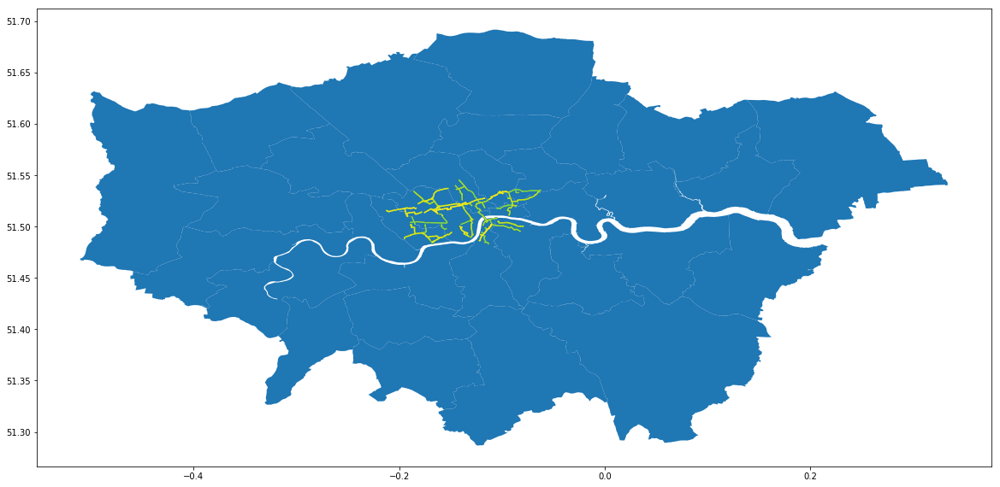

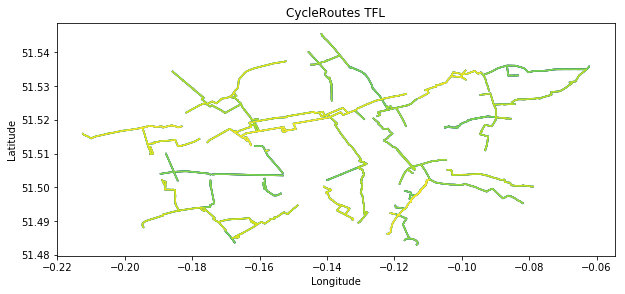

In [43]:
#Read ward shape file
london_gdf = gpd.read_file("statistical-gis-boundaries-london/ESRI/London_Borough_Excluding_MHW.shp")
#read cycleroutes shape file
gpd_cycleroutes = gpd.read_file("CycleRoutes_Cleaned.shp")
gpd_cycleroutes.head()

#Plot choropleth
f, ax = plt.subplots(1,figsize=(20, 20))
gpd_cycleroutes.plot(ax = ax, cmap="viridis", alpha=1, legend=True)
london_gdf.to_crs(epsg="4326").plot(ax=ax)

f, ax = plt.subplots(1, figsize=(10,8))
gpd_cycleroutes.plot(ax = ax, cmap="viridis", alpha=1, legend=True)
plt.title("CycleRoutes TFL")
plt.xlabel("Longitude")
plt.ylabel("Latitude")

london_gdf.head()

##### Clustering ###

In [44]:
from sklearn import cluster
from sklearn.preprocessing import scale
from sklearn.cluster import  KMeans

variables = ['StartStation latitude', 'StartStation longitude', 'StartStation Id Used']
df = df_startStations[variables]
df.head()
#df.info()

,StartStation latitude,StartStation longitude,StartStation Id Used
0,51.516785,-0.104948,2772.0
1,51.508033,-0.106824,2899.0
6,51.518093,-0.091402,3020.0
13,51.541596,-0.125441,3930.0
20,51.466232,-0.113180,4122.0


In [45]:
df_scaled = pd.DataFrame(scale(df[["StartStation latitude", "StartStation longitude"]]), index=df.index, columns={"StartStation latitude", "StartStation longitude"}).rename(lambda x: str(int(x)))


X = df_scaled.values
X[:5]

array([[ 0.53504603,  0.42376824],
       [ 0.10204883,  0.38974914],
       [ 0.59975814,  0.66942591],
       [ 1.76254759,  0.05211489],
       [-1.96601746,  0.27447725]])

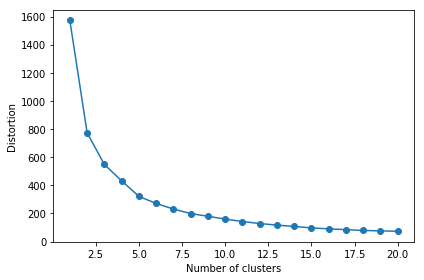

In [46]:
distortions = []
for i in range(1, 21):
    km = KMeans(n_clusters=i, 
                    init='k-means++', # this can be left out, as it is the default
                n_init=10, 
                max_iter=300, 
                random_state=0)
    km.fit(X)
    distortions.append(km.inertia_)
plt.plot(range(1,21), distortions , marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Distortion')
plt.tight_layout()
plt.show()

In [47]:
km = KMeans(n_clusters=8, 
            init='random', # leave this out for k-means++ (see below)
            n_init=10, 
            max_iter=300,
            tol=1e-04,
            random_state=0)
kmcls= km.fit(X)
y_km = km.fit_predict(X)
y_km

array([3, 3, 3, 6, 4, 4, 0, 5, 1, 0, 4, 7, 0, 4, 2, 0, 3, 7, 7, 4, 2, 0,
       7, 1, 7, 4, 7, 0, 3, 4, 7, 7, 0, 7, 7, 0, 5, 4, 7, 5, 0, 5, 0, 5,
       5, 4, 1, 2, 7, 0, 4, 1, 5, 0, 0, 7, 7, 7, 5, 5, 5, 7, 4, 4, 1, 1,
       4, 3, 1, 0, 6, 4, 4, 7, 7, 0, 4, 7, 7, 7, 2, 0, 5, 4, 4, 0, 7, 1,
       7, 7, 3, 7, 5, 7, 1, 6, 0, 1, 3, 6, 7, 0, 1, 7, 7, 5, 4, 6, 5, 0,
       0, 2, 4, 6, 5, 0, 5, 6, 6, 4, 1, 4, 5, 2, 2, 1, 2, 1, 6, 5, 5, 6,
       6, 1, 7, 4, 5, 2, 4, 5, 3, 1, 1, 3, 2, 7, 6, 5, 4, 5, 3, 4, 5, 3,
       7, 4, 2, 7, 1, 4, 1, 1, 5, 7, 3, 2, 0, 2, 5, 3, 4, 1, 5, 5, 7, 4,
       2, 0, 1, 2, 7, 5, 0, 7, 7, 0, 2, 5, 3, 2, 5, 5, 4, 4, 5, 4, 4, 2,
       7, 1, 1, 7, 4, 2, 0, 1, 1, 5, 4, 2, 4, 7, 6, 1, 7, 6, 4, 1, 4, 6,
       4, 7, 5, 5, 7, 5, 1, 5, 5, 2, 4, 4, 3, 5, 2, 2, 5, 5, 4, 6, 2, 4,
       7, 4, 5, 7, 2, 2, 1, 6, 3, 5, 4, 6, 1, 7, 5, 1, 1, 7, 7, 5, 2, 2,
       7, 6, 1, 5, 4, 2, 7, 4, 3, 3, 1, 3, 3, 3, 6, 1, 2, 2, 6, 2, 7, 1,
       0, 5, 5, 1, 7, 6, 4, 7, 4, 2, 3, 5, 6, 7, 2,

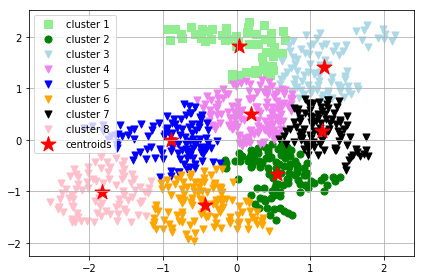

In [48]:
plt.scatter(X[y_km==0,0], 
            X[y_km==0,1], 
            s=50, 
            c='lightgreen', 
            marker='s', 
            label='cluster 1')
plt.scatter(X[y_km==1,0], 
            X[y_km==1,1], 
            s=50, 
            c='green', 
            marker='o', 
            label='cluster 2')
plt.scatter(X[y_km==2,0], 
            X[y_km==2,1], 
            s=50, 
            c='lightblue', 
            marker='v', 
            label='cluster 3')
plt.scatter(X[y_km==3,0], 
            X[y_km==3,1], 
            s=50, 
            c='violet', 
            marker='v', 
            label='cluster 4')
plt.scatter(X[y_km==4,0], 
            X[y_km==4,1], 
            s=50, 
            c='blue', 
            marker='v', 
            label='cluster 5')
plt.scatter(X[y_km==5,0], 
            X[y_km==5,1], 
            s=50, 
            c='orange', 
            marker='v', 
            label='cluster 6')
plt.scatter(X[y_km==6,0], 
            X[y_km==6,1], 
            s=50, 
            c='black', 
            marker='v', 
            label='cluster 7') 
plt.scatter(X[y_km==7,0], 
            X[y_km==7,1], 
            s=50, 
            c='pink', 
            marker='v', 
            label='cluster 8') 
plt.scatter(km.cluster_centers_[:,0], 
            km.cluster_centers_[:,1], 
            s=250, 
            marker='*', 
            c='red', 
            label='centroids') 

plt.legend()
plt.grid()
plt.tight_layout()
#plt.savefig('./figures/centroids.png', dpi=300)
plt.show()

In [49]:
labeled = df.assign(cluster=kmcls.labels_)
labeled.head()

,StartStation latitude,StartStation longitude,StartStation Id Used,cluster
0,51.516785,-0.104948,2772.0,3
1,51.508033,-0.106824,2899.0,3
6,51.518093,-0.091402,3020.0,3
13,51.541596,-0.125441,3930.0,6
20,51.466232,-0.113180,4122.0,4


##### Statistics ####
> Further histogram plots based on weather data (e.g. do more people use bicycles when it rains or when the sun shines?...) Also the histogram plot for usage should be updated (x = Station ID, y = Usage) or (x = StartStation ID and EndStation ID, y= frequency).

In [50]:
df_startStations.head()

,StartStation Id,Duration,StartStation Id Used,StartStation Address,StartStation latitude,StartStation longitude,StartStation capacity
0,835,2640,2772.0,"Farringdon Street, Holborn",51.516785,-0.104948,25
1,839,540,2899.0,"Sea Containers, South Bank",51.508033,-0.106824,30
6,838,1020,3020.0,"Fore Street Avenue, Guildhall",51.518093,-0.091402,25
13,836,1020,3930.0,"York Way, Kings Cross",51.541596,-0.125441,24
20,831,1320,4122.0,"St John's Crescent, Brixton",51.466232,-0.113180,25


In [51]:
variables = ['StartStation Id Used', 'cluster']
Id = df_startStations['StartStation Id']
df_usage = labeled[variables]
df_usage= pd.concat([Id,df_usage], axis=1)
X_usage = df_usage.values

df_usage.head()

,StartStation Id,StartStation Id Used,cluster
0,835,2772.0,3
1,839,2899.0,3
6,838,3020.0,3
13,836,3930.0,6
20,831,4122.0,4


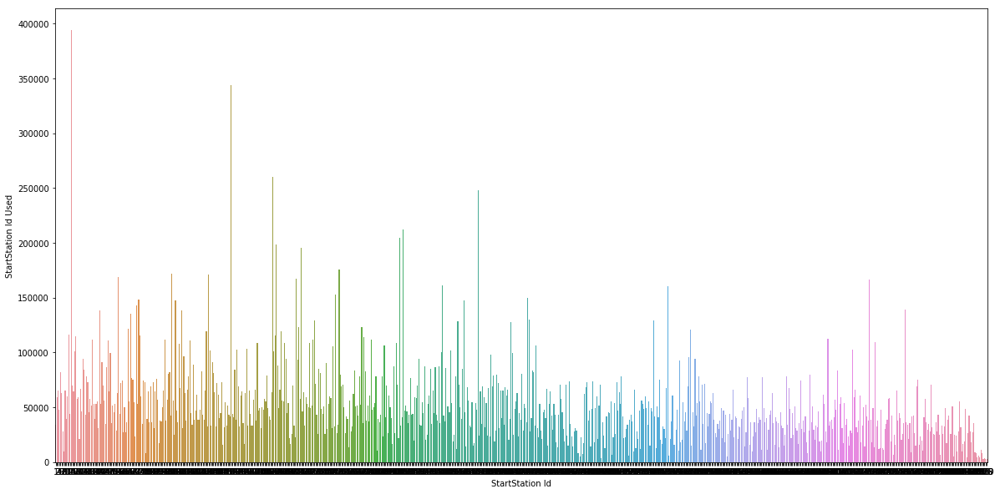

In [53]:
plt.figure(figsize=(20,10))
sns.barplot(x="StartStation Id", y="StartStation Id Used", data=df_usage)

In [54]:
df_top = df_startStations.sort_values(by=['StartStation Id Used'], ascending=False)[:10]
df_top

,StartStation Id,Duration,StartStation Id Used,StartStation Address,StartStation latitude,StartStation longitude,StartStation capacity
70882,14,1020,394178.0,"Belgrove Street , King's Cross",51.529944,-0.123617,48
35360,154,1020,343780.0,"Waterloo Station 3, Waterloo",51.503792,-0.112824,35
35274,191,1020,260537.0,"Hyde Park Corner, Hyde Park",51.503118,-0.153521,28
35183,374,1020,248227.0,"Waterloo Station 1, Waterloo",51.504028,-0.113864,36
34775,307,1016,212601.0,"Black Lion Gate, Kensington Gardens",51.509908,-0.187843,24
70278,303,1020,204864.0,"Albert Gate, Hyde Park",51.502954,-0.158456,28
34723,194,1020,198865.0,"Hop Exchange, The Borough",51.504628,-0.091774,56
34440,217,1002,195626.0,"Wormwood Street, Liverpool Street",51.516155,-0.082422,16
34380,251,1020,175600.0,"Brushfield Street, Liverpool Street",51.518908,-0.079249,34
34263,101,1020,172051.0,"Queen Street 1, Bank",51.511553,-0.092940,22


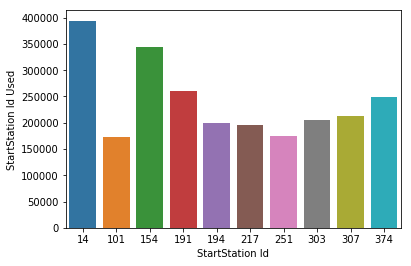

In [55]:
sns.barplot(x="StartStation Id", y="StartStation Id Used", data=df_top)

In [56]:
df_stations.columns = df_stations.columns.str.replace(' ', '_')
df = pd.DataFrame(df_stations.Start_Date.str.split(' ',1).tolist(),
                                   columns = ['Date','time']).drop(columns=['time'])
df.head()

,Date
0,28/02/2019
1,20/12/2018
2,28/02/2019
3,26/02/2019
4,11/01/2019


In [57]:
dfs=pd.concat([df_stations,df], axis=1).sort_values(by=['Date'])

In [58]:
#cols= ['StartStation_Id', 'Date', 'Start_Date', 'EndStation_Id', 'End_Date',
     #  'Duration', 'StartStation_Id_Used', 'EndStation_Id_Used',
     #  'Frequency', 'StartStation_Address', 'StartStation_latitude',
     #  'StartStation_longitude', 'StartStation_capacity',
     #  'EndStation_Address', 'EndStation_latitude',
     #  'EndStation_longitude', 'EndStation_capacity',
     #  'distance_(geodesic)']
#dfs[cols].head()
dfs.head()

,StartStation_Id,Start_Date,EndStation_Id,End_Date,Duration,StartStation_Id_Used,EndStation_Id_Used,Frequency,StartStation_Address,StartStation_latitude,StartStation_longitude,StartStation_capacity,EndStation_Address,EndStation_latitude,EndStation_longitude,EndStation_capacity,distance_(geodesic),Date
941977,232,01/01/2016 16:50:00,71,01/01/2016 17:02:00,720,25967,176874,82,"Carey Street, Holborn",51.515010,-0.112753,16,"Newgate Street , St. Paul's",51.515419,-0.098851,34,0.966130,01/01/2016
4275587,64,01/01/2016 13:16:00,338,01/01/2016 13:51:00,2100,122049,94707,292,"William IV Street, Strand",51.509462,-0.124749,26,"Wellington Street , Strand",51.511756,-0.119643,24,0.436817,01/01/2016
6785279,512,01/01/2016 05:37:00,772,01/01/2016 07:00:00,4980,78472,70153,9,"Pritchard's Road, Bethnal Green",51.532091,-0.061420,30,"Binfield Road, Stockwell",51.472510,-0.122832,35,7.882023,01/01/2016
4275303,130,01/01/2016 03:04:00,570,01/01/2016 06:14:00,11400,119042,47054,179,"Tower Gardens , Tower",51.509506,-0.075459,24,"Upper Bank Street, Canary Wharf",51.503083,-0.017676,36,4.075113,01/01/2016
6785278,512,01/01/2016 05:38:00,772,01/01/2016 07:00:00,4920,78472,70153,9,"Pritchard's Road, Bethnal Green",51.532091,-0.061420,30,"Binfield Road, Stockwell",51.472510,-0.122832,35,7.882023,01/01/2016


In [63]:
# Save the usage of all routes
df_routes.to_csv(r"C:\Users\Pascal\Desktop\Cycles_Cleaned\cycleusage_cleansed.csv", index=None, header=True)